In [ ]:
import os
import numpy as np
import torch
import matplotlib.pyplot as plt
from PIL import Image
from sam2.build_sam import build_sam2_video_predictor

In [ ]:
if torch.cuda.is_available():
    device = torch.device("cuda")
if device.type == "cuda":
    torch.autocast("cuda", dtype=torch.bfloat16).__enter__()
else:
    print("CUDA not available")


In [ ]:



sam2_checkpoint = "/sam2.1_hiera_tiny.pt"
model_cfg = "/configs/sam2.1/sam2.1_hiera_t.yaml"


predictor = build_sam2_video_predictor(model_cfg, sam2_checkpoint, device=device)

fintuned_model_path = ""
predictor.load_state_dict(torch.load(fintuned_model_path))


<All keys matched successfully>

In [ ]:
def show_mask(mask, ax, obj_id=None, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        cmap = plt.get_cmap("tab10")
        cmap_idx = 0 if obj_id is None else obj_id
        color = np.array([*cmap(cmap_idx)[:3], 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)


def show_points(coords, labels, ax, marker_size=200):
    pos_points = coords[labels==1]
    neg_points = coords[labels==0]
    ax.scatter(pos_points[:, 0], pos_points[:, 1], color='green', marker='.', s=marker_size, edgecolor='white', linewidth=1.25)
    ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='.', s=marker_size, edgecolor='white', linewidth=1.25)

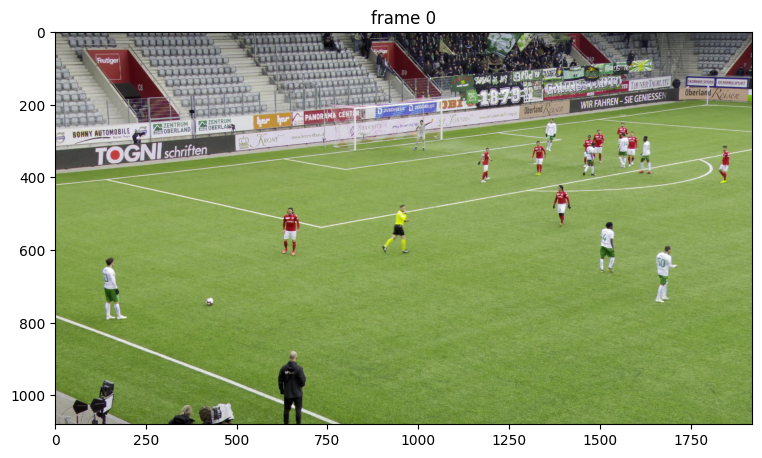

In [ ]:

video_dir = ""

frame_names = [
    p for p in os.listdir(video_dir)
    if os.path.splitext(p)[-1] in [".jpg", ".jpeg", ".JPG", ".JPEG"]
]
frame_names.sort(key=lambda p: int(os.path.splitext(p)[0]))

frame_idx = 0
# plt.figure(figsize=(10, 10))
plt.title(f"frame {frame_idx}")
plt.axis("off")
plt.imshow(Image.open(os.path.join(video_dir, frame_names[frame_idx])))

In [ ]:
inference_state = predictor.init_state(video_path=video_dir)
predictor.reset_state(inference_state)
prompts = {}

frame loading (JPEG): 100%|██████████| 750/750 [00:43<00:00, 17.24it/s]


In [ ]:
predictor.reset_state(inference_state)

center_points_path = ""
centers = np.load(center_points_path, allow_pickle=True).item()
features = {'Full field':1, 'Big rect. left':2, 'Big rect. right':2, 'Goal left':3, 'Goal right':3, 'Circle right':4, 'Circle left':4, 'Circle central':5, 'Small rect. left':6, 'Small rect. right':6}
mapper = {0:0, 1:1, 2:1, 3:2, 4:2, 5:3, 6:3, 7:4, 8:5, 9:5}

remove_feature = []

for ann_frame_idx in range(0, len(frame_names), 25):

    prompts = {}
    centers_maks = centers[ann_frame_idx]

    image_pts = []
    point_labels = []
    found_masks = []

    for cls in centers_maks:
        
        x_point, y_point = centers_maks[cls]

        points = np.array([[int(x_point), int(y_point)]], dtype=np.float32)
        point_label = np.array([1], np.int32)
        

        labels = point_label
        prompts[mapper[cls]] = points, labels
        # prompts[cls] = points, labels
        _, out_obj_ids, out_mask_logits = predictor.add_new_points_or_box(
            inference_state=inference_state,
            frame_idx=ann_frame_idx,
            obj_id=mapper[cls],
            # obj_id=cls,
            points=points,
            labels=labels,
        )

    # showing the results on the current (interacted) frame
    plt.figure(figsize=(10, 10))
    plt.title(f"Frame {ann_frame_idx}")
    plt.axis('off')
    plt.imshow(Image.open(os.path.join(video_dir, frame_names[ann_frame_idx])))

    base_save_path = "frame_" + str(ann_frame_idx) + ".png"
    
    for i, out_obj_id in enumerate(out_obj_ids):
        if out_obj_id in prompts:
            
            coords1, labels1 = prompts[out_obj_id]
            show_points(coords1, labels1, plt.gca())
        show_mask((out_mask_logits[i] > 0.0).cpu().numpy(), plt.gca(), obj_id=out_obj_id)
        plt.savefig(base_save_path, bbox_inches='tight')




In [ ]:
video_segments = {} 
for out_frame_idx, out_obj_ids, out_mask_logits in predictor.propagate_in_video(inference_state):
    video_segments[out_frame_idx] = {
        out_obj_id: (out_mask_logits[i] > 0.0).cpu().numpy()
        for i, out_obj_id in enumerate(out_obj_ids)
    }

propagate in video: 100%|██████████| 750/750 [03:00<00:00,  4.15it/s]


/tmp/ipykernel_3147470/2411360401.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(10, 10))


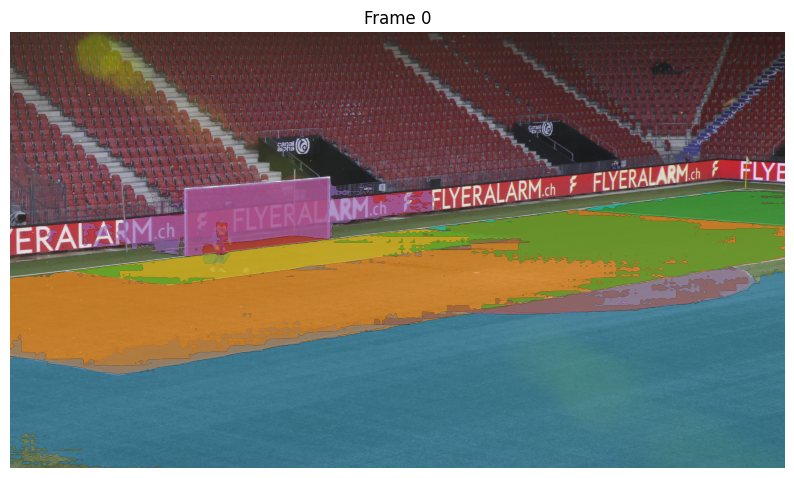

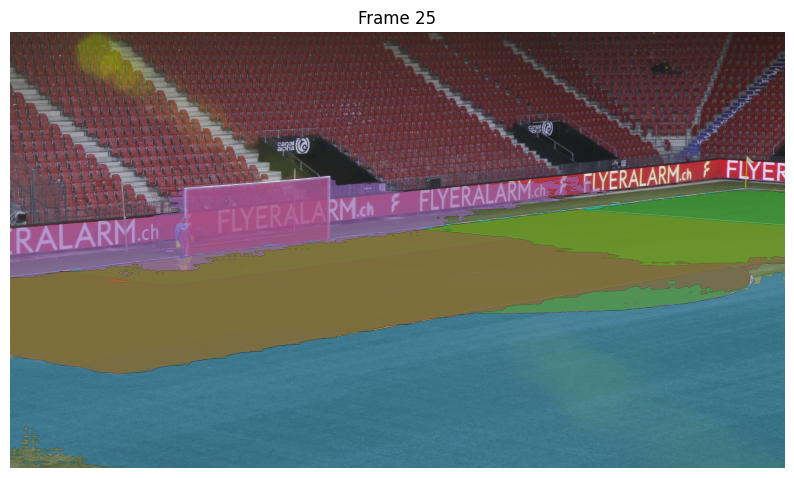

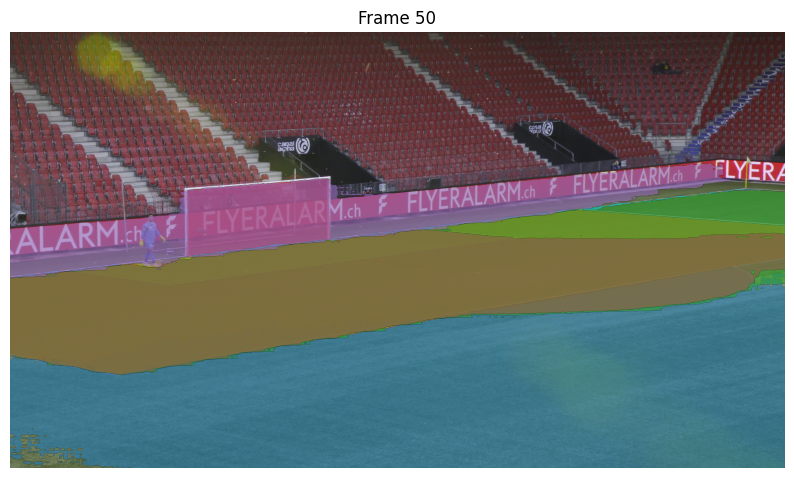

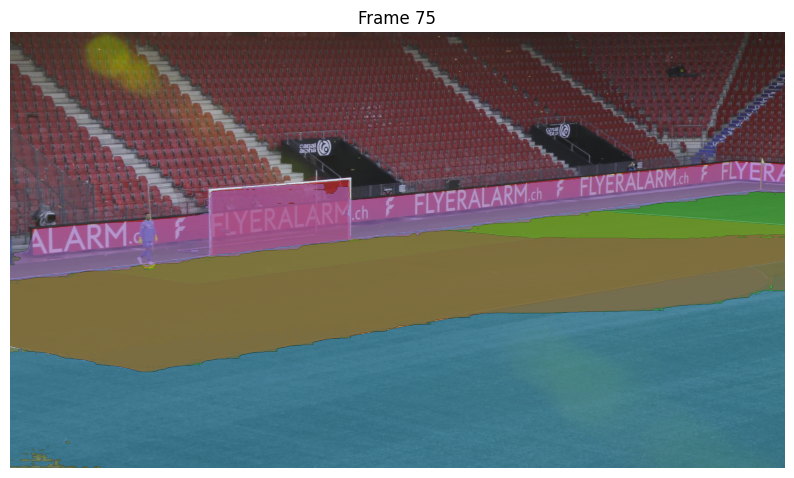

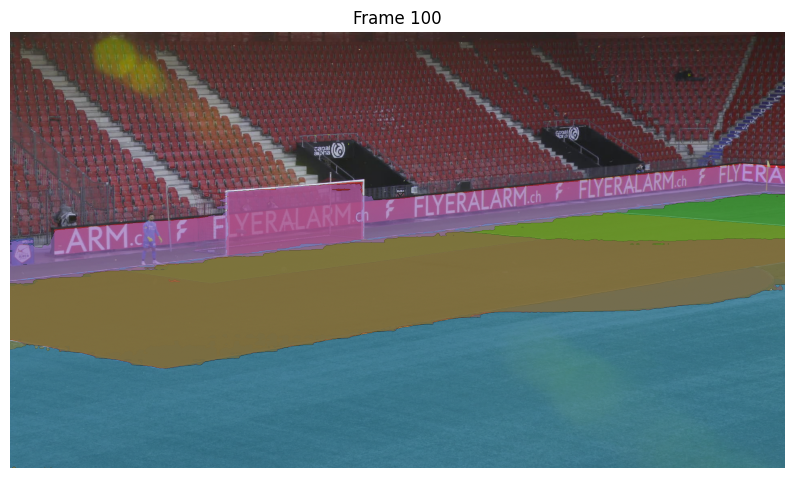

...

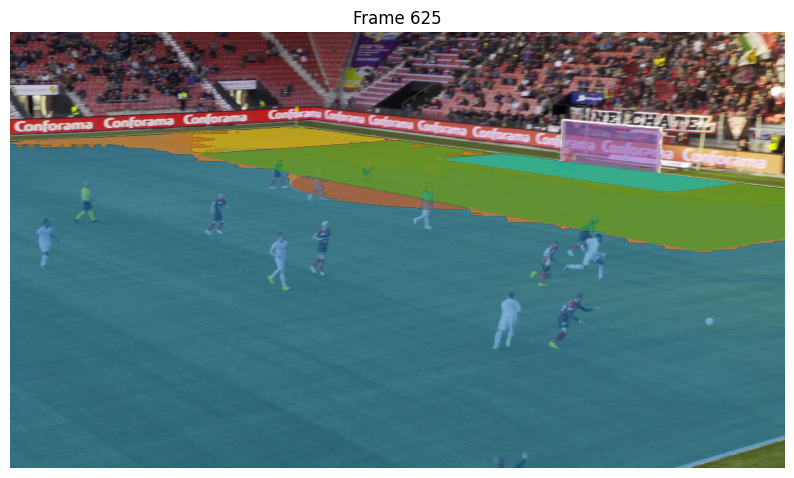

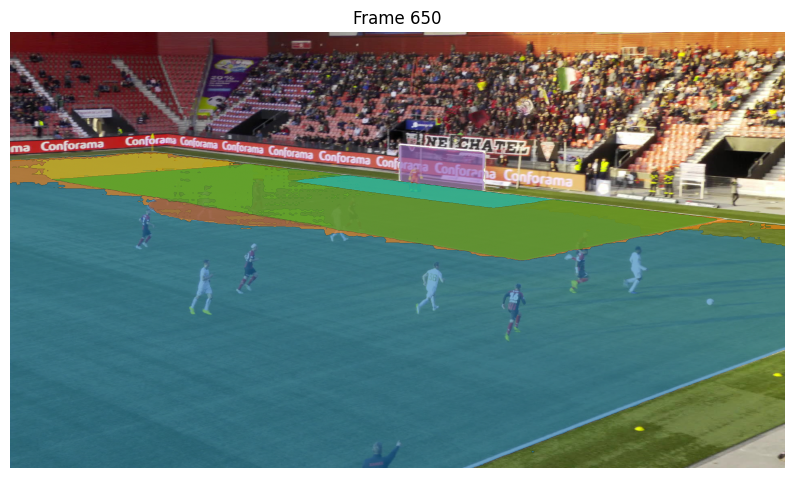

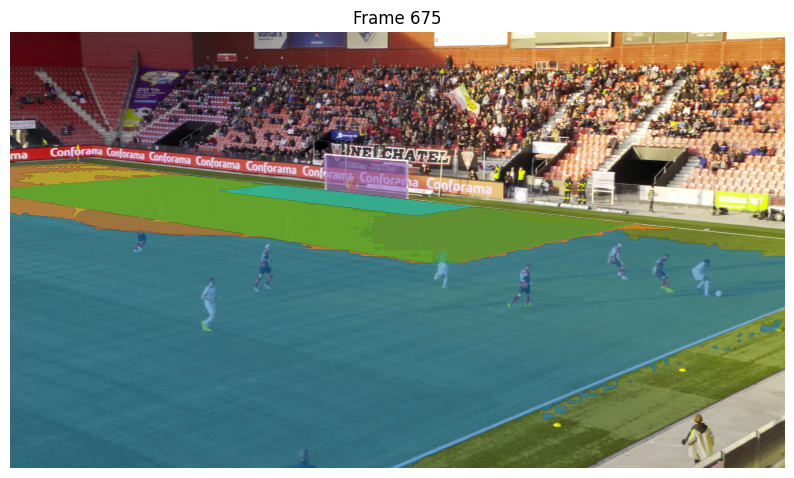

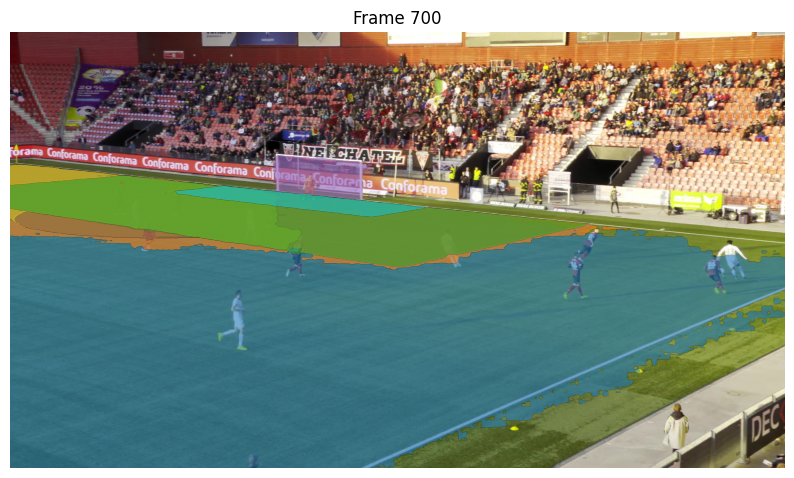

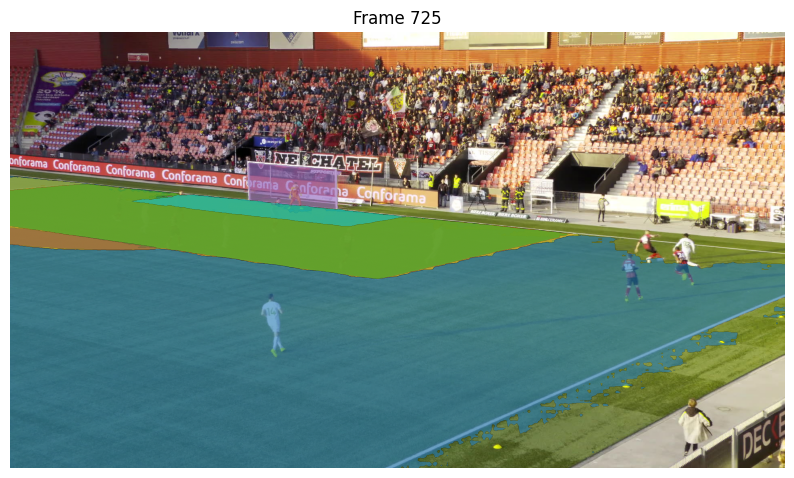

In [ ]:

plt.ioff()

show_frame_stride = 1
plt.close("all")
for out_frame_idx in range(0, len(frame_names), show_frame_stride):
    plt.figure(figsize=(10, 10))
    plt.title(f"Frame {out_frame_idx}")
    plt.axis("off")
    base_save_path = "frame_" + str(out_frame_idx) + ".png"

    plt.imshow(Image.open(os.path.join(video_dir, frame_names[out_frame_idx])))
    for out_obj_id, out_mask in video_segments[out_frame_idx].items():
        show_mask(out_mask, plt.gca(), obj_id=out_obj_id)
    plt.savefig(base_save_path, bbox_inches='tight')

    